In [1]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Dense, Activation, Flatten, BatchNormalization, Conv2D, MaxPool2D,Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model
from tensorflow.keras.applications import imagenet_utils
from sklearn.metrics import confusion_matrix
from tensorflow.keras.optimizers import Adam
import itertools
import os
import shutil
import random
import matplotlib.pyplot as plt
%matplotlib inline
from tensorflow.keras.models import Sequential

import cv2

E:\Anaconda\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
train_ds = 'dataset/train'
valid_ds = 'dataset/val'
test_ds = 'dataset/test'

# Data preProcess

In [3]:
train_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input).flow_from_directory(
    directory=train_ds, target_size=(224,224), batch_size=10)
valid_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input).flow_from_directory(
    directory=valid_ds, target_size=(224,224), batch_size=10)
test_batches = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet.preprocess_input).flow_from_directory(
    directory=test_ds, target_size=(224,224), batch_size=10, shuffle=False)

Found 1447 images belonging to 7 classes.
Found 177 images belonging to 7 classes.
Found 188 images belonging to 7 classes.


In [4]:
test_batches.class_indices

{'Corynespora': 0,
 'Healthy': 1,
 'Other': 2,
 'Pesta': 3,
 'Powdery mildew': 4,
 'birds eye': 5,
 'colletorichum leaf disease': 6}

In [5]:
train_batches.class_indices

{'Corynespora': 0,
 'Healthy': 1,
 'Other': 2,
 'Pesta': 3,
 'Powdery mildew': 4,
 'birds eye': 5,
 'colletorichum leaf disease': 6}

In [6]:
import tensorflow as tf


mobile_net_v2 = tf.keras.applications.MobileNetV2()

In [7]:
mobile_net_v2.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_1[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[

 block_3_expand_relu (ReLU)  (None, 56, 56, 144)          0         ['block_3_expand_BN[0][0]']   
                                                                                                  
 block_3_pad (ZeroPadding2D  (None, 57, 57, 144)          0         ['block_3_expand_relu[0][0]'] 
 )                                                                                                
                                                                                                  
 block_3_depthwise (Depthwi  (None, 28, 28, 144)          1296      ['block_3_pad[0][0]']         
 seConv2D)                                                                                        
                                                                                                  
 block_3_depthwise_BN (Batc  (None, 28, 28, 144)          576       ['block_3_depthwise[0][0]']   
 hNormalization)                                                                                  
          

 block_6_depthwise_BN (Batc  (None, 14, 14, 192)          768       ['block_6_depthwise[0][0]']   
 hNormalization)                                                                                  
                                                                                                  
 block_6_depthwise_relu (Re  (None, 14, 14, 192)          0         ['block_6_depthwise_BN[0][0]']
 LU)                                                                                              
                                                                                                  
 block_6_project (Conv2D)    (None, 14, 14, 64)           12288     ['block_6_depthwise_relu[0][0]
                                                                    ']                            
                                                                                                  
 block_6_project_BN (BatchN  (None, 14, 14, 64)           256       ['block_6_project[0][0]']     
 ormalizat

                                                                                                  
 block_9_add (Add)           (None, 14, 14, 64)           0         ['block_8_add[0][0]',         
                                                                     'block_9_project_BN[0][0]']  
                                                                                                  
 block_10_expand (Conv2D)    (None, 14, 14, 384)          24576     ['block_9_add[0][0]']         
                                                                                                  
 block_10_expand_BN (BatchN  (None, 14, 14, 384)          1536      ['block_10_expand[0][0]']     
 ormalization)                                                                                    
                                                                                                  
 block_10_expand_relu (ReLU  (None, 14, 14, 384)          0         ['block_10_expand_BN[0][0]']  
 )        

                                                                                                  
 block_13_expand_relu (ReLU  (None, 14, 14, 576)          0         ['block_13_expand_BN[0][0]']  
 )                                                                                                
                                                                                                  
 block_13_pad (ZeroPadding2  (None, 15, 15, 576)          0         ['block_13_expand_relu[0][0]']
 D)                                                                                               
                                                                                                  
 block_13_depthwise (Depthw  (None, 7, 7, 576)            5184      ['block_13_pad[0][0]']        
 iseConv2D)                                                                                       
                                                                                                  
 block_13_

 iseConv2D)                                                                                       
                                                                                                  
 block_16_depthwise_BN (Bat  (None, 7, 7, 960)            3840      ['block_16_depthwise[0][0]']  
 chNormalization)                                                                                 
                                                                                                  
 block_16_depthwise_relu (R  (None, 7, 7, 960)            0         ['block_16_depthwise_BN[0][0]'
 eLU)                                                               ]                             
                                                                                                  
 block_16_project (Conv2D)   (None, 7, 7, 320)            307200    ['block_16_depthwise_relu[0][0
                                                                    ]']                           
          

# Remove last 2 layers in the mobile_net_v2

In [8]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
mobile_net_v2 = MobileNetV2(weights='imagenet', include_top=True)


new_model = tf.keras.Model(inputs=mobile_net_v2.input, outputs=mobile_net_v2.layers[-2].output)


new_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_2[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[0][0]']        

 block_3_expand_relu (ReLU)  (None, 56, 56, 144)          0         ['block_3_expand_BN[0][0]']   
                                                                                                  
 block_3_pad (ZeroPadding2D  (None, 57, 57, 144)          0         ['block_3_expand_relu[0][0]'] 
 )                                                                                                
                                                                                                  
 block_3_depthwise (Depthwi  (None, 28, 28, 144)          1296      ['block_3_pad[0][0]']         
 seConv2D)                                                                                        
                                                                                                  
 block_3_depthwise_BN (Batc  (None, 28, 28, 144)          576       ['block_3_depthwise[0][0]']   
 hNormalization)                                                                                  
          

 block_6_depthwise_BN (Batc  (None, 14, 14, 192)          768       ['block_6_depthwise[0][0]']   
 hNormalization)                                                                                  
                                                                                                  
 block_6_depthwise_relu (Re  (None, 14, 14, 192)          0         ['block_6_depthwise_BN[0][0]']
 LU)                                                                                              
                                                                                                  
 block_6_project (Conv2D)    (None, 14, 14, 64)           12288     ['block_6_depthwise_relu[0][0]
                                                                    ']                            
                                                                                                  
 block_6_project_BN (BatchN  (None, 14, 14, 64)           256       ['block_6_project[0][0]']     
 ormalizat

                                                                                                  
 block_9_add (Add)           (None, 14, 14, 64)           0         ['block_8_add[0][0]',         
                                                                     'block_9_project_BN[0][0]']  
                                                                                                  
 block_10_expand (Conv2D)    (None, 14, 14, 384)          24576     ['block_9_add[0][0]']         
                                                                                                  
 block_10_expand_BN (BatchN  (None, 14, 14, 384)          1536      ['block_10_expand[0][0]']     
 ormalization)                                                                                    
                                                                                                  
 block_10_expand_relu (ReLU  (None, 14, 14, 384)          0         ['block_10_expand_BN[0][0]']  
 )        

                                                                                                  
 block_13_expand_relu (ReLU  (None, 14, 14, 576)          0         ['block_13_expand_BN[0][0]']  
 )                                                                                                
                                                                                                  
 block_13_pad (ZeroPadding2  (None, 15, 15, 576)          0         ['block_13_expand_relu[0][0]']
 D)                                                                                               
                                                                                                  
 block_13_depthwise (Depthw  (None, 7, 7, 576)            5184      ['block_13_pad[0][0]']        
 iseConv2D)                                                                                       
                                                                                                  
 block_13_

 iseConv2D)                                                                                       
                                                                                                  
 block_16_depthwise_BN (Bat  (None, 7, 7, 960)            3840      ['block_16_depthwise[0][0]']  
 chNormalization)                                                                                 
                                                                                                  
 block_16_depthwise_relu (R  (None, 7, 7, 960)            0         ['block_16_depthwise_BN[0][0]'
 eLU)                                                               ]                             
                                                                                                  
 block_16_project (Conv2D)   (None, 7, 7, 320)            307200    ['block_16_depthwise_relu[0][0
                                                                    ]']                           
          

# Add new layer 

In [9]:
num_classes = 7
new_last_layer = tf.keras.layers.Dense(num_classes, activation='softmax')(new_model.output)

# Create the final model with the new last layer
final_model = tf.keras.Model(inputs=new_model.input, outputs=new_last_layer)

# Print the summary of the final model
final_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_2[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[0][0]']      

 block_3_expand_relu (ReLU)  (None, 56, 56, 144)          0         ['block_3_expand_BN[0][0]']   
                                                                                                  
 block_3_pad (ZeroPadding2D  (None, 57, 57, 144)          0         ['block_3_expand_relu[0][0]'] 
 )                                                                                                
                                                                                                  
 block_3_depthwise (Depthwi  (None, 28, 28, 144)          1296      ['block_3_pad[0][0]']         
 seConv2D)                                                                                        
                                                                                                  
 block_3_depthwise_BN (Batc  (None, 28, 28, 144)          576       ['block_3_depthwise[0][0]']   
 hNormalization)                                                                                  
          

 block_6_depthwise_BN (Batc  (None, 14, 14, 192)          768       ['block_6_depthwise[0][0]']   
 hNormalization)                                                                                  
                                                                                                  
 block_6_depthwise_relu (Re  (None, 14, 14, 192)          0         ['block_6_depthwise_BN[0][0]']
 LU)                                                                                              
                                                                                                  
 block_6_project (Conv2D)    (None, 14, 14, 64)           12288     ['block_6_depthwise_relu[0][0]
                                                                    ']                            
                                                                                                  
 block_6_project_BN (BatchN  (None, 14, 14, 64)           256       ['block_6_project[0][0]']     
 ormalizat

                                                                                                  
 block_9_add (Add)           (None, 14, 14, 64)           0         ['block_8_add[0][0]',         
                                                                     'block_9_project_BN[0][0]']  
                                                                                                  
 block_10_expand (Conv2D)    (None, 14, 14, 384)          24576     ['block_9_add[0][0]']         
                                                                                                  
 block_10_expand_BN (BatchN  (None, 14, 14, 384)          1536      ['block_10_expand[0][0]']     
 ormalization)                                                                                    
                                                                                                  
 block_10_expand_relu (ReLU  (None, 14, 14, 384)          0         ['block_10_expand_BN[0][0]']  
 )        

                                                                                                  
 block_13_expand_relu (ReLU  (None, 14, 14, 576)          0         ['block_13_expand_BN[0][0]']  
 )                                                                                                
                                                                                                  
 block_13_pad (ZeroPadding2  (None, 15, 15, 576)          0         ['block_13_expand_relu[0][0]']
 D)                                                                                               
                                                                                                  
 block_13_depthwise (Depthw  (None, 7, 7, 576)            5184      ['block_13_pad[0][0]']        
 iseConv2D)                                                                                       
                                                                                                  
 block_13_

 iseConv2D)                                                                                       
                                                                                                  
 block_16_depthwise_BN (Bat  (None, 7, 7, 960)            3840      ['block_16_depthwise[0][0]']  
 chNormalization)                                                                                 
                                                                                                  
 block_16_depthwise_relu (R  (None, 7, 7, 960)            0         ['block_16_depthwise_BN[0][0]'
 eLU)                                                               ]                             
                                                                                                  
 block_16_project (Conv2D)   (None, 7, 7, 320)            307200    ['block_16_depthwise_relu[0][0
                                                                    ]']                           
          

In [10]:
final_model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [11]:
history=final_model.fit(x=train_batches,
            steps_per_epoch=len(train_batches),
            validation_data=valid_batches,
            validation_steps=len(valid_batches),
            epochs=10,
            verbose=2
)

Epoch 1/10
145/145 - 145s - loss: 0.3764 - accuracy: 0.8839 - val_loss: 0.2951 - val_accuracy: 0.9153 - 145s/epoch - 999ms/step
Epoch 2/10
145/145 - 175s - loss: 0.0661 - accuracy: 0.9834 - val_loss: 0.1104 - val_accuracy: 0.9774 - 175s/epoch - 1s/step
Epoch 3/10
145/145 - 170s - loss: 0.0399 - accuracy: 0.9896 - val_loss: 0.1348 - val_accuracy: 0.9548 - 170s/epoch - 1s/step
Epoch 4/10
145/145 - 172s - loss: 0.0186 - accuracy: 0.9959 - val_loss: 0.0820 - val_accuracy: 0.9605 - 172s/epoch - 1s/step
Epoch 5/10
145/145 - 171s - loss: 0.0319 - accuracy: 0.9917 - val_loss: 0.0300 - val_accuracy: 0.9944 - 171s/epoch - 1s/step
Epoch 6/10
145/145 - 171s - loss: 0.0308 - accuracy: 0.9931 - val_loss: 0.0329 - val_accuracy: 0.9887 - 171s/epoch - 1s/step
Epoch 7/10
145/145 - 170s - loss: 0.0155 - accuracy: 0.9965 - val_loss: 0.0219 - val_accuracy: 0.9944 - 170s/epoch - 1s/step
Epoch 8/10
145/145 - 171s - loss: 0.0231 - accuracy: 0.9945 - val_loss: 0.0263 - val_accuracy: 0.9944 - 171s/epoch - 1s/st

In [12]:
import os.path
final_model.save('V4.0.h5')

C:\Users\User\AppData\Roaming\Python\Python39\site-packages\keras\src\engine\training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [13]:
scores = final_model.evaluate(test_batches)

19/19 [==============================] - 6s 340ms/step - loss: 0.0090 - accuracy: 0.9947


In [14]:
final_accuracy = history.history['accuracy'][-1]
print(f"Final Accuracy: {final_accuracy * 100:.2f}%")

Final Accuracy: 99.38%


In [15]:
scores = final_model.evaluate(train_batches)

145/145 [==============================] - 45s 310ms/step - loss: 0.0047 - accuracy: 0.9993


In [17]:
converter = tf.lite.TFLiteConverter.from_keras_model(final_model)
tflite_model = converter.convert()

# Define the complete path and filename for saving the model
tflite_model_path = "C:/Users/User/Desktop/Models(FYP)/mobileNet_Try/TenserflowLite/final_model4.tflite"

# Save the TensorFlow Lite model to the specified location
with open(tflite_model_path, 'wb') as f:
    f.write(tflite_model)

print(f"TensorFlow Lite model saved at: {tflite_model_path}")

INFO:tensorflow:Assets written to: C:\Users\User\AppData\Local\Temp\tmpeqr_2rqn\assets


INFO:tensorflow:Assets written to: C:\Users\User\AppData\Local\Temp\tmpeqr_2rqn\assets


TensorFlow Lite model saved at: C:/Users/User/Desktop/Models(FYP)/mobileNet_Try/TenserflowLite/final_model4.tflite


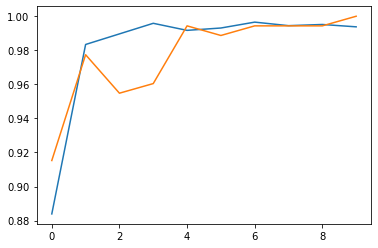

In [18]:
import matplotlib.pyplot as plt
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])

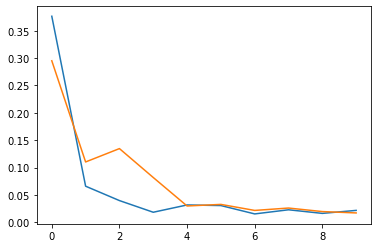

In [19]:
import matplotlib.pyplot as plt
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])

In [20]:
test_labels = test_batches.classes

In [21]:
predictions = final_model.predict(x=test_batches, steps=len(test_batches), verbose=0)

In [22]:
predictions

array([[9.99992490e-01, 9.35559569e-07, 5.54009477e-11, ...,
        9.84927806e-10, 6.39532300e-06, 5.09909199e-08],
       [9.99934793e-01, 8.73573995e-08, 3.07320636e-09, ...,
        1.53271618e-08, 6.50420479e-05, 3.09649657e-08],
       [9.99946475e-01, 9.62528611e-06, 1.75647552e-10, ...,
        6.44710596e-09, 7.15110730e-07, 2.75446126e-07],
       ...,
       [2.15620057e-05, 1.70643136e-04, 1.73482011e-08, ...,
        1.91889867e-05, 4.54353663e-04, 9.99333203e-01],
       [2.35507468e-06, 7.94353909e-05, 7.41882644e-08, ...,
        8.62239540e-06, 3.09066236e-05, 9.99857426e-01],
       [5.58338434e-06, 5.21492111e-05, 1.07866924e-10, ...,
        6.15378553e-07, 6.16099060e-05, 9.99877930e-01]], dtype=float32)

In [23]:
np.round(predictions)

array([[1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 0., 1.]], dtype=float32)

In [30]:
cm = confusion_matrix(y_true=test_labels, y_pred=predictions.argmax(axis=1))

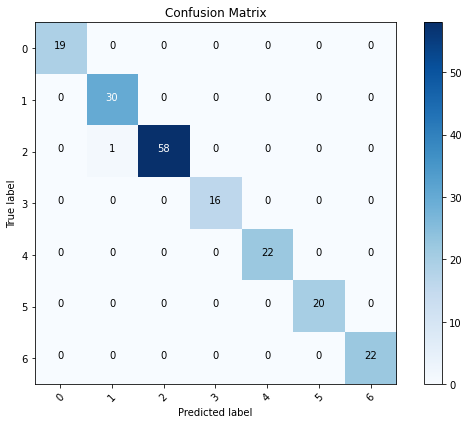

In [31]:
cm_plot_labels = ['0','1','2','3','4','5','6']
plot_confusion_matrix(cm=cm, classes=cm_plot_labels, title='Confusion Matrix')

In [32]:
# Assuming you have preprocessed your test data into 'test_batches' (similar to how you preprocessed your train and validation data)
# 'test_batches' should be an instance of ImageDataGenerator.flow_from_directory()

# Get predictions from the model
predictions = final_model.predict(test_batches)

# Convert predicted probabilities to class labels
predicted_labels = predictions.argmax(axis=-1)

# Get actual labels from the 'test_batches' object
actual_labels = test_batches.classes

# Get class names from the 'test_batches' object
class_names = list(test_batches.class_indices.keys())

# Iterate through the test batch and print image filename, predicted class name, and actual class name
for i in range(len(test_batches.filenames)):
    image_filename = test_batches.filenames[i]
    predicted_class_name = class_names[predicted_labels[i]]
    actual_class_name = class_names[actual_labels[i]]
    
    
    print(f"Image: {image_filename} | Predicted: {predicted_class_name} | Actual: {actual_class_name}" )

19/19 [==============================] - 7s 361ms/step
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.32.29 AM.jpeg | Predicted: Corynespora | Actual: Corynespora
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.32.34 AM.jpeg | Predicted: Corynespora | Actual: Corynespora
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.32.40 AM.jpeg | Predicted: Corynespora | Actual: Corynespora
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.34.00 AM.jpeg | Predicted: Corynespora | Actual: Corynespora
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.34.01 AM.jpeg | Predicted: Corynespora | Actual: Corynespora
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.34.14 AM.jpeg | Predicted: Corynespora | Actual: Corynespora
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.34.24 AM.jpeg | Predicted: Corynespora | Actual: Corynespora
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.34.34 AM.jpeg | Predicted: Corynespora | Actual: Corynespora
Image: Corynespora\WhatsApp Image 2023-04-12 at 1

In [33]:
# Assuming you have preprocessed your test data into 'test_batches' (similar to how you preprocessed your train and validation data)
# 'test_batches' should be an instance of ImageDataGenerator.flow_from_directory()

# Get predictions from the model
predictions = final_model.predict(test_batches)

# Convert predicted probabilities to class labels
predicted_labels = predictions.argmax(axis=-1)

# Get actual labels from the 'test_batches' object
actual_labels = test_batches.classes

# Get class names from the 'test_batches' object
class_names = list(test_batches.class_indices.keys())

# Iterate through the test batch and print image filename, predicted class name, actual class name, and confidence percentage
for i in range(len(test_batches.filenames)):
    image_filename = test_batches.filenames[i]
    predicted_class_name = class_names[predicted_labels[i]]
    actual_class_name = class_names[actual_labels[i]]
    
    # Get the confidence percentage for the predicted class
    confidence_percentage = predictions[i][predicted_labels[i]] * 100.0
    
    print(f"Image: {image_filename} | Predicted: {predicted_class_name} | Actual: {actual_class_name} | Confidence: {confidence_percentage:.2f}%")


19/19 [==============================] - 7s 392ms/step
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.32.29 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.32.34 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 99.99%
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.32.40 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 99.99%
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.34.00 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.34.01 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.34.14 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%
Image: Corynespora\WhatsApp Image 2023-04-12 at 10.34.24 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%
Image: Co

19/19 [==============================] - 7s 358ms/step


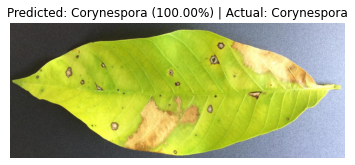

Image: Corynespora\WhatsApp Image 2023-04-12 at 10.32.29 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%


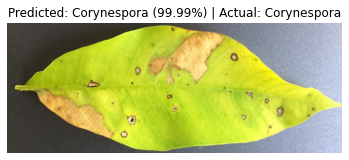

Image: Corynespora\WhatsApp Image 2023-04-12 at 10.32.34 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 99.99%


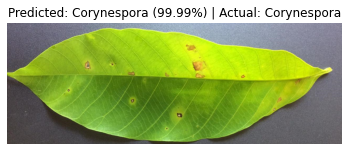

Image: Corynespora\WhatsApp Image 2023-04-12 at 10.32.40 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 99.99%


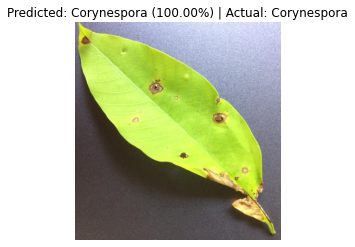

Image: Corynespora\WhatsApp Image 2023-04-12 at 10.34.00 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%


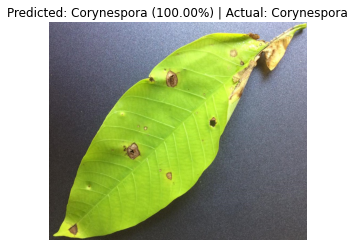

Image: Corynespora\WhatsApp Image 2023-04-12 at 10.34.01 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%


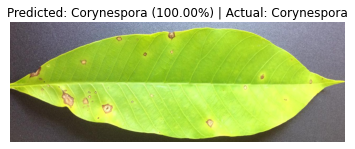

Image: Corynespora\WhatsApp Image 2023-04-12 at 10.34.14 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%


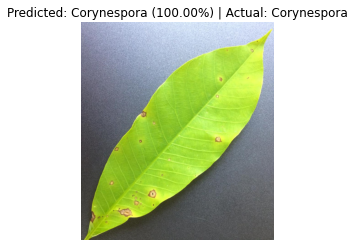

Image: Corynespora\WhatsApp Image 2023-04-12 at 10.34.24 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%


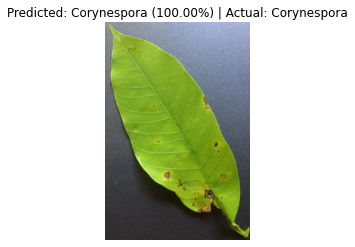

Image: Corynespora\WhatsApp Image 2023-04-12 at 10.34.34 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%


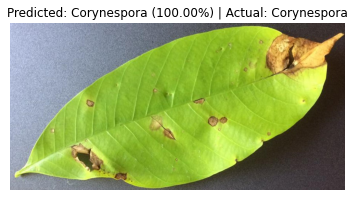

Image: Corynespora\WhatsApp Image 2023-04-12 at 10.37.34 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%


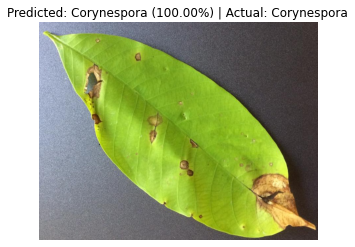

Image: Corynespora\WhatsApp Image 2023-04-12 at 10.37.35 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%


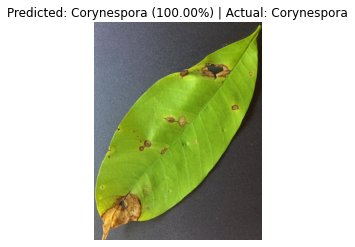

Image: Corynespora\WhatsApp Image 2023-04-12 at 10.37.50 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%


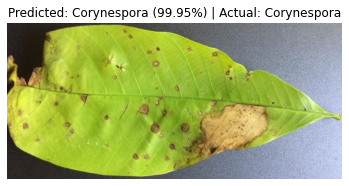

Image: Corynespora\WhatsApp Image 2023-04-12 at 10.38.13 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 99.95%


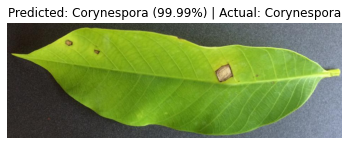

Image: Corynespora\WhatsApp Image 2023-04-12 at 10.38.22 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 99.99%


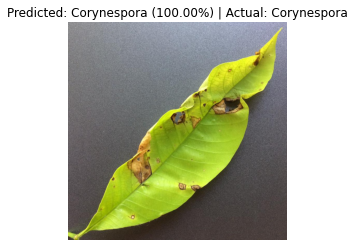

Image: Corynespora\WhatsApp Image 2023-04-12 at 10.40.30 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%


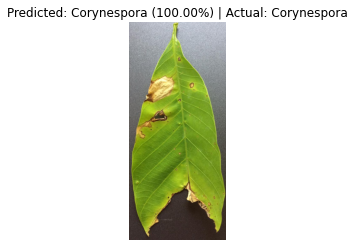

Image: Corynespora\WhatsApp Image 2023-04-12 at 11.10.10 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%


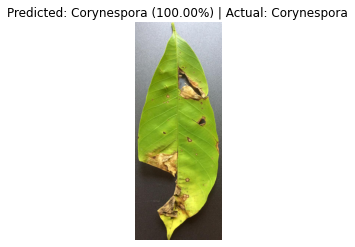

Image: Corynespora\WhatsApp Image 2023-04-12 at 11.10.59 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%


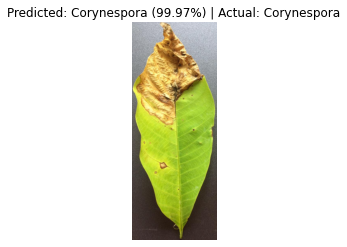

Image: Corynespora\WhatsApp Image 2023-04-12 at 11.12.17 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 99.97%


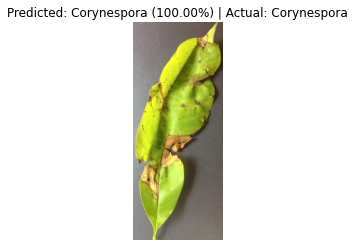

Image: Corynespora\WhatsApp Image 2023-04-12 at 11.13.06 AM.jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 100.00%


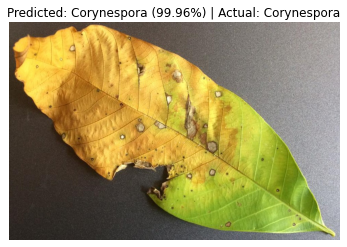

Image: Corynespora\WhatsApp Image 2023-04-12 at 11.13.26 AM (1).jpeg | Predicted: Corynespora | Actual: Corynespora | Confidence: 99.96%


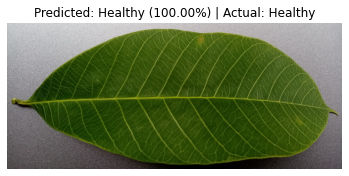

Image: Healthy\IMG_20230323_113856.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


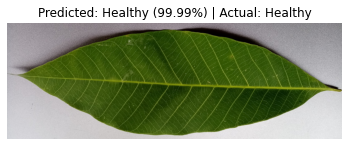

Image: Healthy\IMG_20230323_114110.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 99.99%


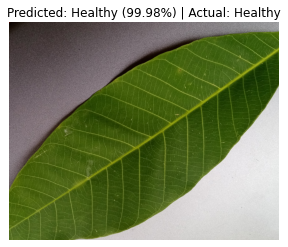

Image: Healthy\IMG_20230323_114116.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 99.98%


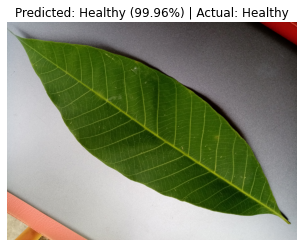

Image: Healthy\IMG_20230323_114125.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 99.96%


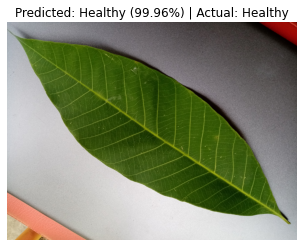

Image: Healthy\IMG_20230323_114126.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 99.96%


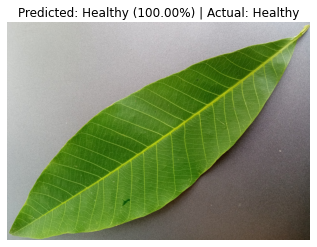

Image: Healthy\IMG_20230323_115040.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


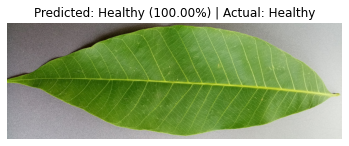

Image: Healthy\IMG_20230323_115233.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


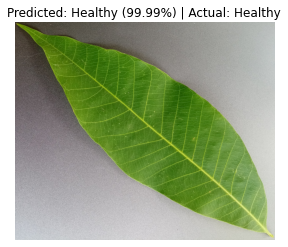

Image: Healthy\IMG_20230323_115253.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 99.99%


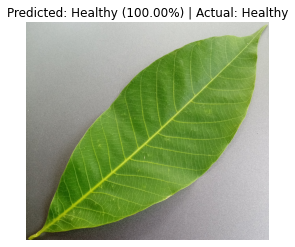

Image: Healthy\IMG_20230323_115417.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


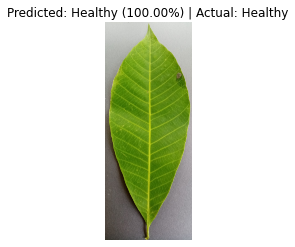

Image: Healthy\IMG_20230323_115640.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


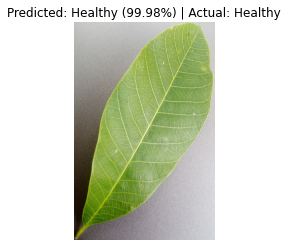

Image: Healthy\IMG_20230323_115747.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 99.98%


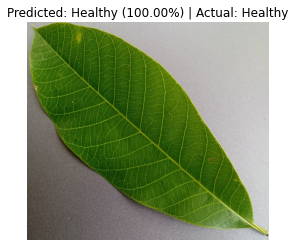

Image: Healthy\IMG_20230323_115754.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


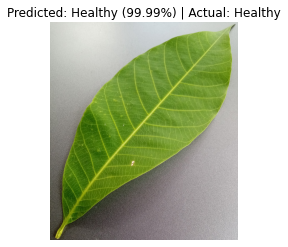

Image: Healthy\IMG_20230323_120037.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 99.99%


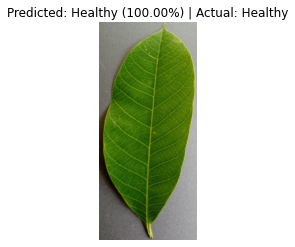

Image: Healthy\IMG_20230323_122429.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


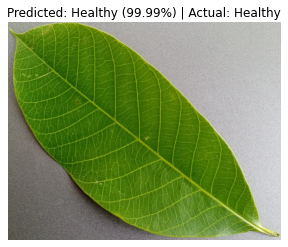

Image: Healthy\IMG_20230323_122434.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 99.99%


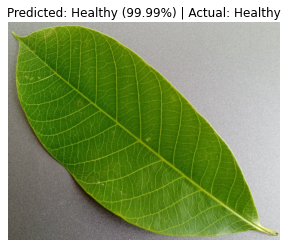

Image: Healthy\IMG_20230323_122436.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 99.99%


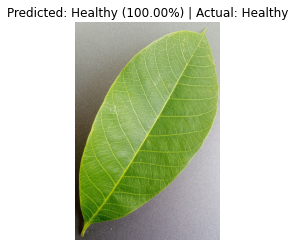

Image: Healthy\IMG_20230323_122447.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


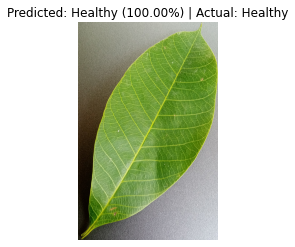

Image: Healthy\IMG_20230323_122602.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


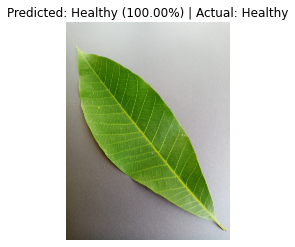

Image: Healthy\IMG_20230323_122639.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


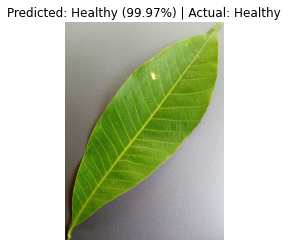

Image: Healthy\IMG_20230323_122902.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 99.97%


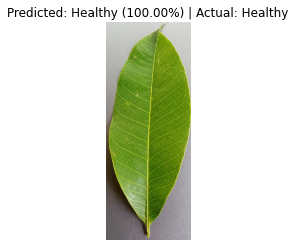

Image: Healthy\IMG_20230323_122946.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


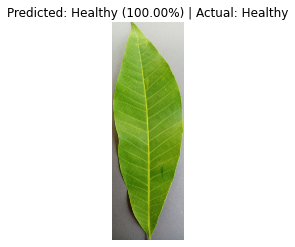

Image: Healthy\IMG_20230323_123422.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


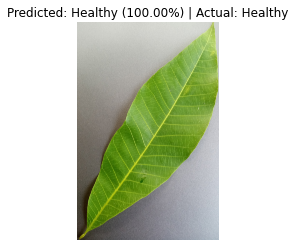

Image: Healthy\IMG_20230323_123429.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


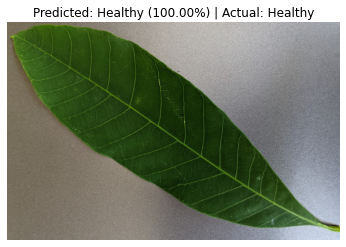

Image: Healthy\PXL_20230729_064146192.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


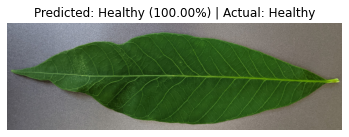

Image: Healthy\PXL_20230729_064206759.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


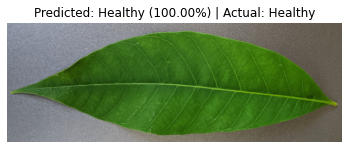

Image: Healthy\PXL_20230729_064339864.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


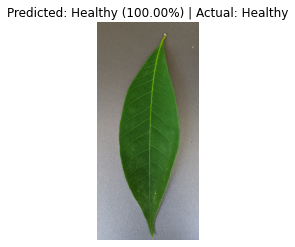

Image: Healthy\PXL_20230729_064632350.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


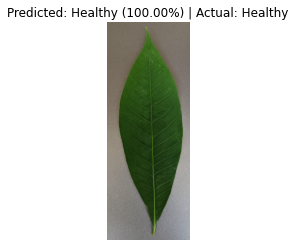

Image: Healthy\PXL_20230729_064736897.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


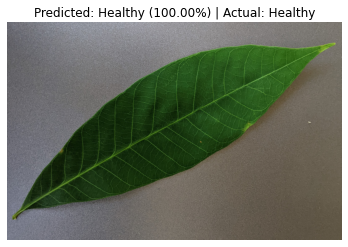

Image: Healthy\PXL_20230729_064800804.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


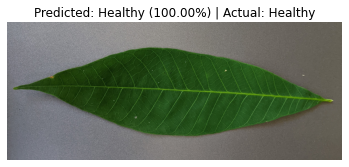

Image: Healthy\PXL_20230729_064816244.jpg | Predicted: Healthy | Actual: Healthy | Confidence: 100.00%


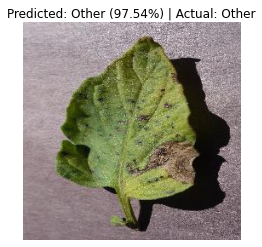

Image: Other\00e7c4b2-3005-4558-9cfa-235e356cb7a8___RS_Erly.B 7844.JPG | Predicted: Other | Actual: Other | Confidence: 97.54%


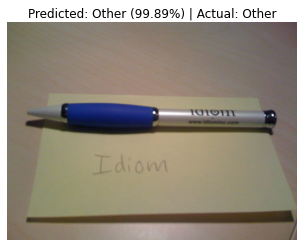

Image: Other\085e00cca29a39a5.jpg | Predicted: Other | Actual: Other | Confidence: 99.89%


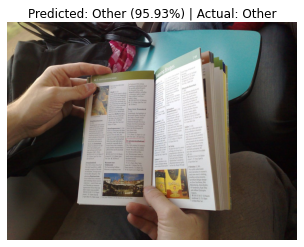

Image: Other\08e6091538ee52b7.jpg | Predicted: Other | Actual: Other | Confidence: 95.93%


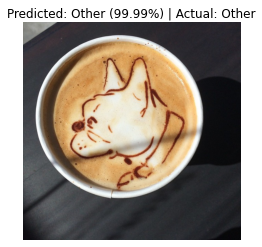

Image: Other\09d251bc6d2df174.jpg | Predicted: Other | Actual: Other | Confidence: 99.99%


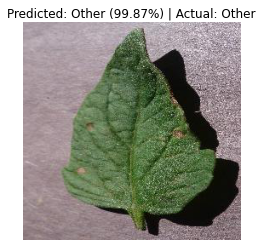

Image: Other\0a2726e0-3358-4a46-b6dc-563a5a9f2bdf___RS_Erly.B 7860.JPG | Predicted: Other | Actual: Other | Confidence: 99.87%


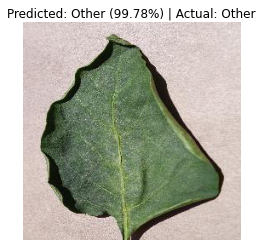

Image: Other\0b796b7a-dfc8-47f7-9970-8373263c6408___JR_HL 5948.JPG | Predicted: Other | Actual: Other | Confidence: 99.78%


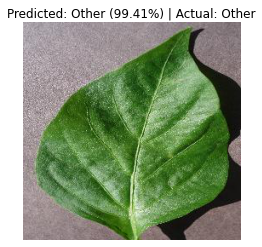

Image: Other\0ba474dd-0cfd-4fd2-a58c-8e3d18dbe7c3___JR_HL 8395.JPG | Predicted: Other | Actual: Other | Confidence: 99.41%


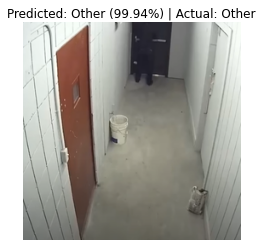

Image: Other\109.png | Predicted: Other | Actual: Other | Confidence: 99.94%


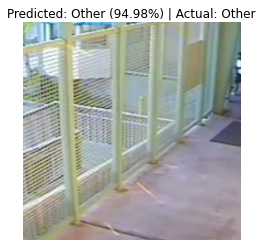

Image: Other\116.png | Predicted: Other | Actual: Other | Confidence: 94.98%


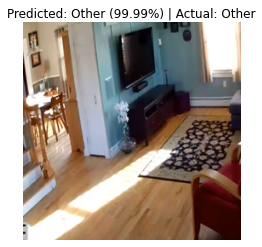

Image: Other\117.png | Predicted: Other | Actual: Other | Confidence: 99.99%


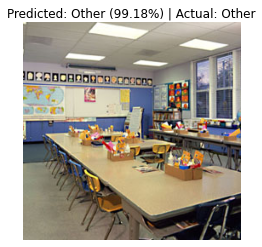

Image: Other\122.png | Predicted: Other | Actual: Other | Confidence: 99.18%


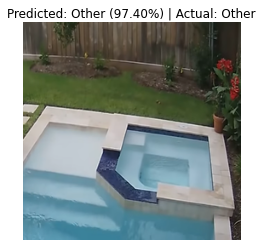

Image: Other\126.png | Predicted: Other | Actual: Other | Confidence: 97.40%


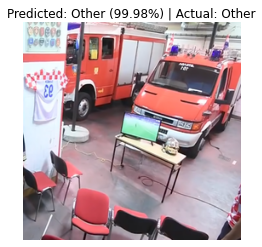

Image: Other\127.png | Predicted: Other | Actual: Other | Confidence: 99.98%


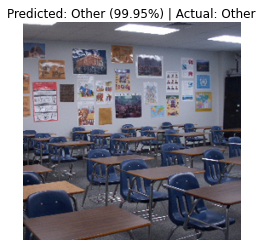

Image: Other\130.png | Predicted: Other | Actual: Other | Confidence: 99.95%


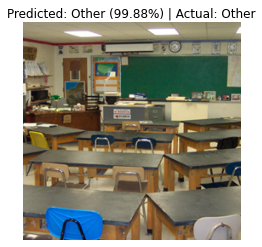

Image: Other\133.png | Predicted: Other | Actual: Other | Confidence: 99.88%


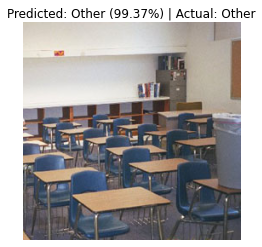

Image: Other\134.png | Predicted: Other | Actual: Other | Confidence: 99.37%


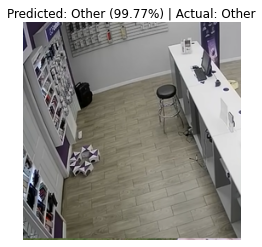

Image: Other\141.png | Predicted: Other | Actual: Other | Confidence: 99.77%


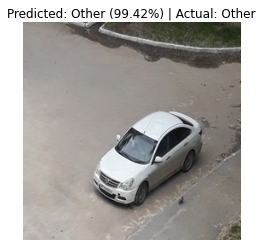

Image: Other\164.png | Predicted: Other | Actual: Other | Confidence: 99.42%


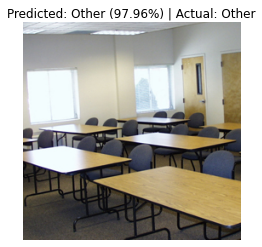

Image: Other\178.png | Predicted: Other | Actual: Other | Confidence: 97.96%


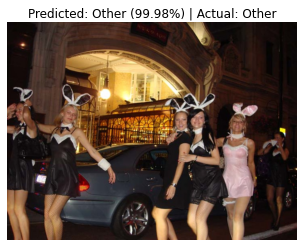

Image: Other\1dc4d19cfeca2421.jpg | Predicted: Other | Actual: Other | Confidence: 99.98%


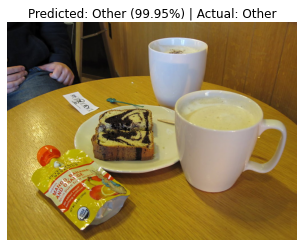

Image: Other\21b82de28bc70499.jpg | Predicted: Other | Actual: Other | Confidence: 99.95%


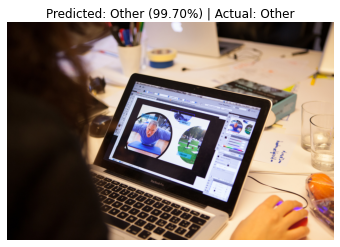

Image: Other\22e93d5ee6c9e5c4.jpg | Predicted: Other | Actual: Other | Confidence: 99.70%


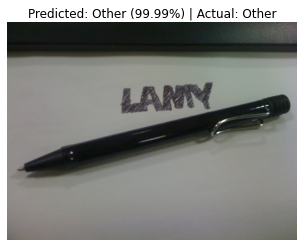

Image: Other\37ab15d8a57e6002.jpg | Predicted: Other | Actual: Other | Confidence: 99.99%


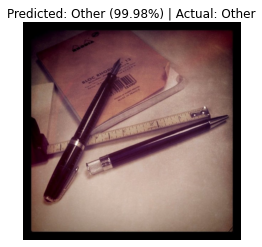

Image: Other\3ee29febdf5fd6ac.jpg | Predicted: Other | Actual: Other | Confidence: 99.98%


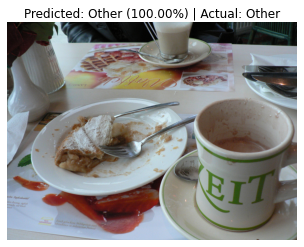

Image: Other\4f2d1d0a898e5c2e.jpg | Predicted: Other | Actual: Other | Confidence: 100.00%


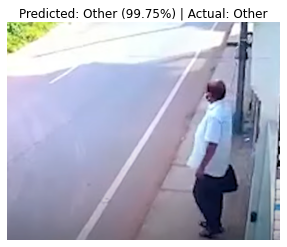

Image: Other\526.png | Predicted: Other | Actual: Other | Confidence: 99.75%


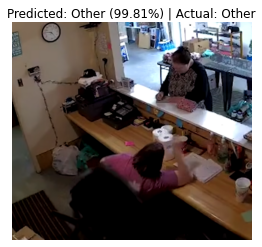

Image: Other\528.png | Predicted: Other | Actual: Other | Confidence: 99.81%


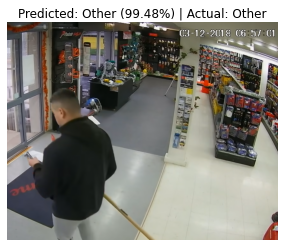

Image: Other\54.png | Predicted: Other | Actual: Other | Confidence: 99.48%


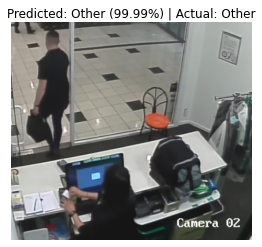

Image: Other\57.png | Predicted: Other | Actual: Other | Confidence: 99.99%


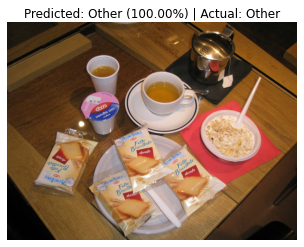

Image: Other\5a34eaf52f89ee64.jpg | Predicted: Other | Actual: Other | Confidence: 100.00%


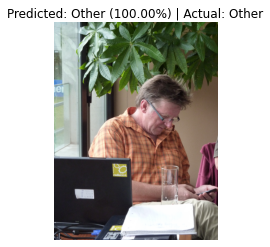

Image: Other\5d631de9509744c5.jpg | Predicted: Other | Actual: Other | Confidence: 100.00%


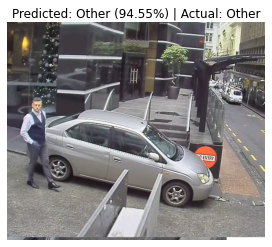

Image: Other\66.png | Predicted: Other | Actual: Other | Confidence: 94.55%


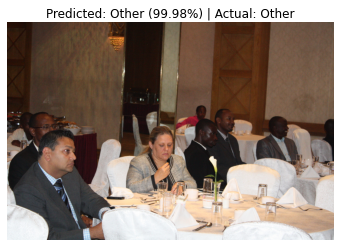

Image: Other\6b6b69d16b9381ec.jpg | Predicted: Other | Actual: Other | Confidence: 99.98%


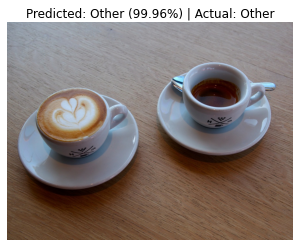

Image: Other\6e2ad08632651953.jpg | Predicted: Other | Actual: Other | Confidence: 99.96%


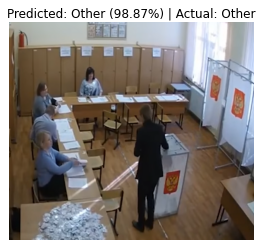

Image: Other\73.png | Predicted: Other | Actual: Other | Confidence: 98.87%


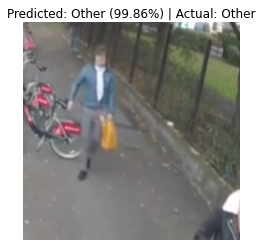

Image: Other\75.png | Predicted: Other | Actual: Other | Confidence: 99.86%


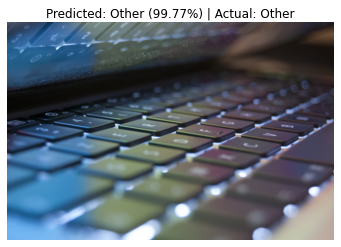

Image: Other\8dee57eb181f7e0c.jpg | Predicted: Other | Actual: Other | Confidence: 99.77%


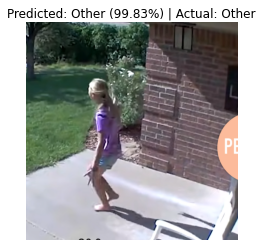

Image: Other\90.png | Predicted: Other | Actual: Other | Confidence: 99.83%


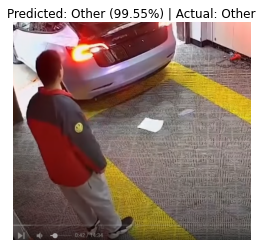

Image: Other\92.png | Predicted: Other | Actual: Other | Confidence: 99.55%


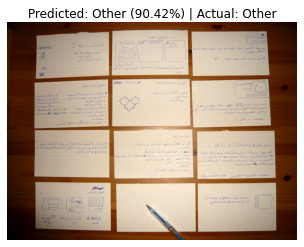

Image: Other\9dfa56a94ede771d.jpg | Predicted: Other | Actual: Other | Confidence: 90.42%


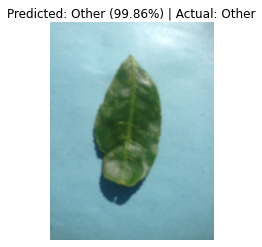

Image: Other\UNADJUSTEDNONRAW_thumb_20c.jpg | Predicted: Other | Actual: Other | Confidence: 99.86%


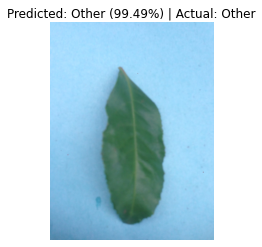

Image: Other\UNADJUSTEDNONRAW_thumb_21f.jpg | Predicted: Other | Actual: Other | Confidence: 99.49%


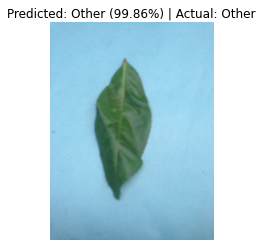

Image: Other\UNADJUSTEDNONRAW_thumb_22e.jpg | Predicted: Other | Actual: Other | Confidence: 99.86%


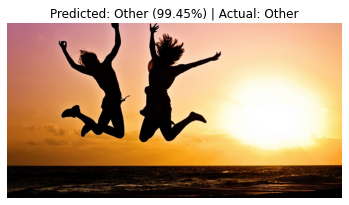

Image: Other\_happy_jumping_on_beach-40815.jpg | Predicted: Other | Actual: Other | Confidence: 99.45%


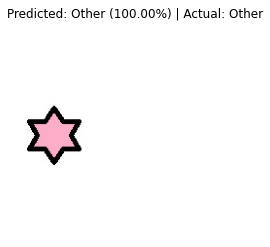

Image: Other\a (11).jpg | Predicted: Other | Actual: Other | Confidence: 100.00%


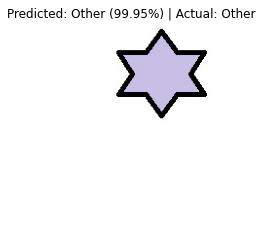

Image: Other\a (6).jpg | Predicted: Other | Actual: Other | Confidence: 99.95%


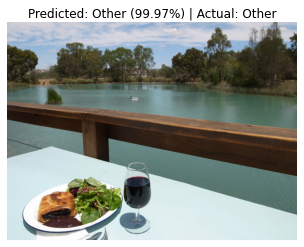

Image: Other\a5221b122aff9ed3.jpg | Predicted: Other | Actual: Other | Confidence: 99.97%


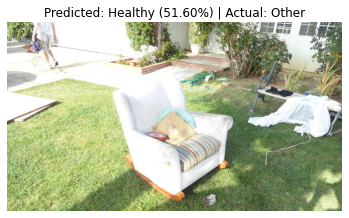

Image: Other\a649e3790f842b39.jpg | Predicted: Healthy | Actual: Other | Confidence: 51.60%


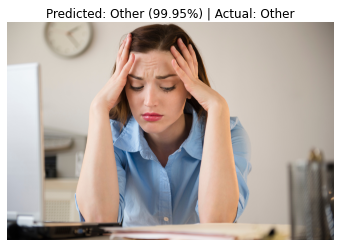

Image: Other\crying-at-work.jpg | Predicted: Other | Actual: Other | Confidence: 99.95%


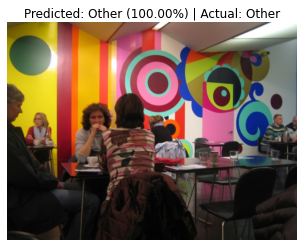

Image: Other\d3220952292c9db9.jpg | Predicted: Other | Actual: Other | Confidence: 100.00%


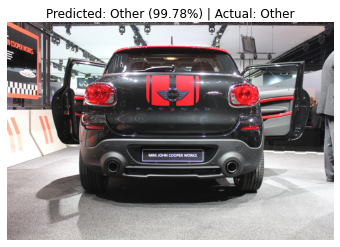

Image: Other\e4dfa4939e00fec4.jpg | Predicted: Other | Actual: Other | Confidence: 99.78%


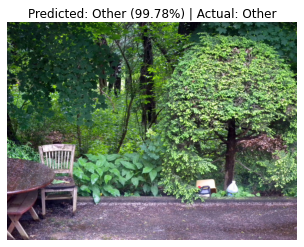

Image: Other\f0db69219a3fada4.jpg | Predicted: Other | Actual: Other | Confidence: 99.78%


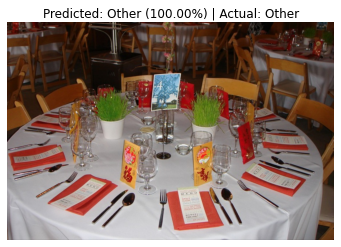

Image: Other\f9fde77706161f48.jpg | Predicted: Other | Actual: Other | Confidence: 100.00%


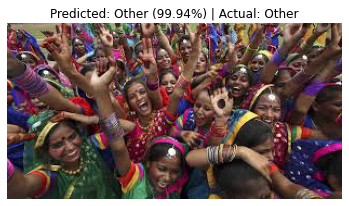

Image: Other\images17.jpg | Predicted: Other | Actual: Other | Confidence: 99.94%


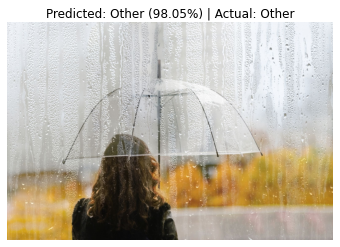

Image: Other\sad-quotes-lead-image-1677524157.jpg | Predicted: Other | Actual: Other | Confidence: 98.05%


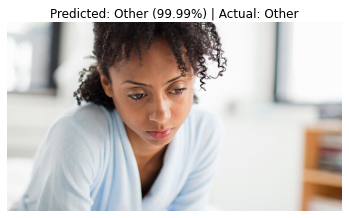

Image: Other\secret-signs-of-loneliness-01-1440x810.jpg | Predicted: Other | Actual: Other | Confidence: 99.99%


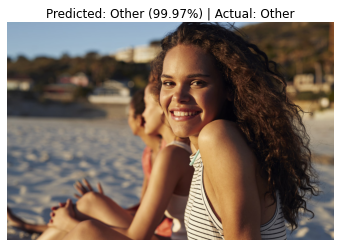

Image: Other\tmp_6mv7xy_5d5b15258a507669_GettyImages-847741712.jpg | Predicted: Other | Actual: Other | Confidence: 99.97%


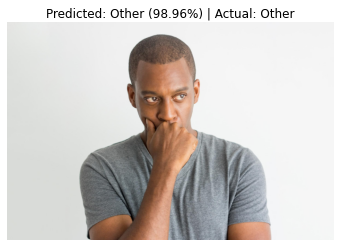

Image: Other\upsetman.jpg | Predicted: Other | Actual: Other | Confidence: 98.96%


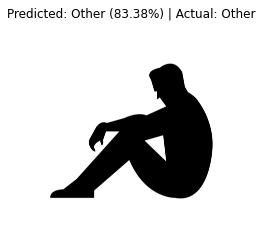

Image: Other\vector-sad-man-sitting-silhouette.jpg | Predicted: Other | Actual: Other | Confidence: 83.38%


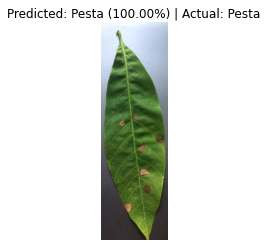

Image: Pesta\WhatsApp Image 2023-04-12 at 11.42.02 AM.jpeg | Predicted: Pesta | Actual: Pesta | Confidence: 100.00%


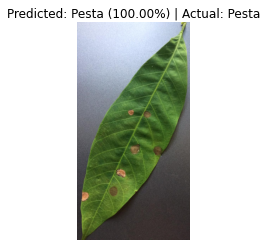

Image: Pesta\WhatsApp Image 2023-04-12 at 11.42.03 AM.jpeg | Predicted: Pesta | Actual: Pesta | Confidence: 100.00%


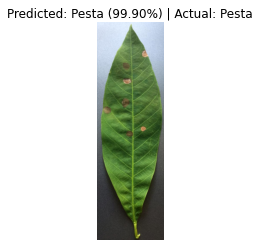

Image: Pesta\WhatsApp Image 2023-04-12 at 11.42.06 AM.jpeg | Predicted: Pesta | Actual: Pesta | Confidence: 99.90%


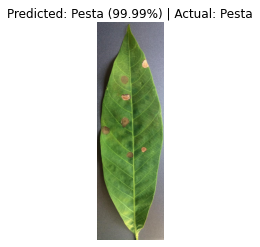

Image: Pesta\WhatsApp Image 2023-04-12 at 11.42.08 AM.jpeg | Predicted: Pesta | Actual: Pesta | Confidence: 99.99%


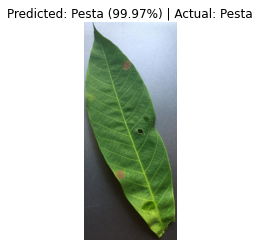

Image: Pesta\WhatsApp Image 2023-04-12 at 11.43.54 AM.jpeg | Predicted: Pesta | Actual: Pesta | Confidence: 99.97%


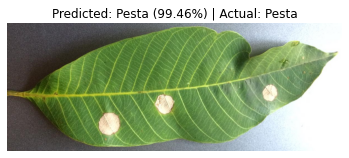

Image: Pesta\WhatsApp Image 2023-04-12 at 11.50.09 AM.jpeg | Predicted: Pesta | Actual: Pesta | Confidence: 99.46%


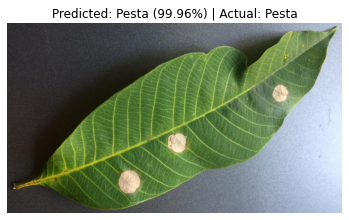

Image: Pesta\WhatsApp Image 2023-04-12 at 11.59.11 AM.jpeg | Predicted: Pesta | Actual: Pesta | Confidence: 99.96%


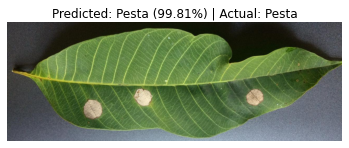

Image: Pesta\WhatsApp Image 2023-04-12 at 11.59.17 AM.jpeg | Predicted: Pesta | Actual: Pesta | Confidence: 99.81%


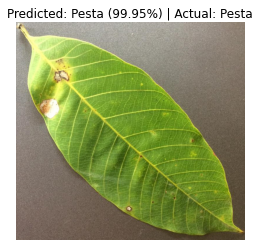

Image: Pesta\WhatsApp Image 2023-04-12 at 11.59.31 AM.jpeg | Predicted: Pesta | Actual: Pesta | Confidence: 99.95%


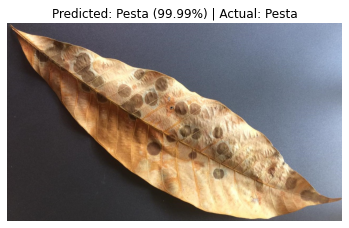

Image: Pesta\WhatsApp Image 2023-04-12 at 12.00.03 PM.jpeg | Predicted: Pesta | Actual: Pesta | Confidence: 99.99%


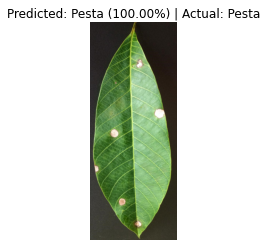

Image: Pesta\WhatsApp Image 2023-04-12 at 12.04.49 PM.jpeg | Predicted: Pesta | Actual: Pesta | Confidence: 100.00%


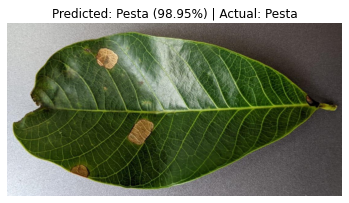

Image: Pesta\q15.jpg | Predicted: Pesta | Actual: Pesta | Confidence: 98.95%


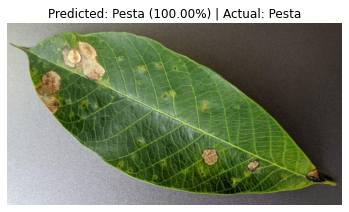

Image: Pesta\q16.jpg | Predicted: Pesta | Actual: Pesta | Confidence: 100.00%


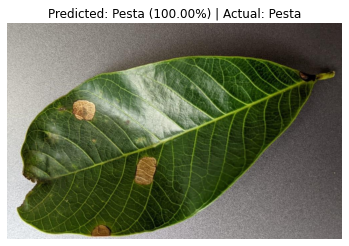

Image: Pesta\q17.jpg | Predicted: Pesta | Actual: Pesta | Confidence: 100.00%


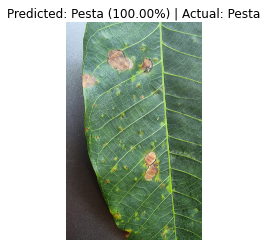

Image: Pesta\x16.jpg | Predicted: Pesta | Actual: Pesta | Confidence: 100.00%


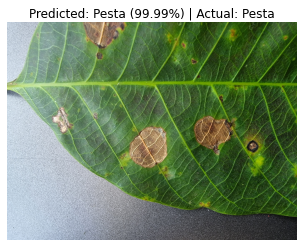

Image: Pesta\x25.jpg | Predicted: Pesta | Actual: Pesta | Confidence: 99.99%


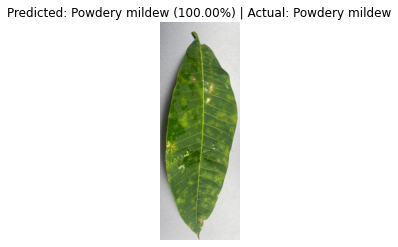

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.11.35 PM (7).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


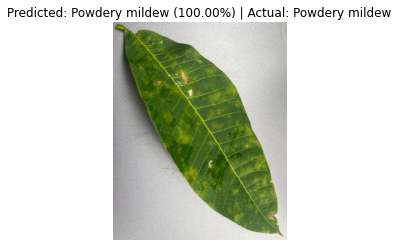

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.11.35 PM (8).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


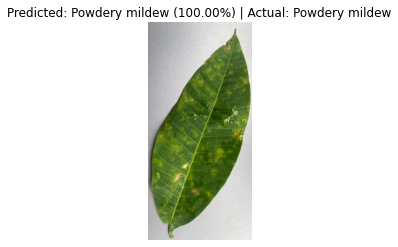

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.11.35 PM (9).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


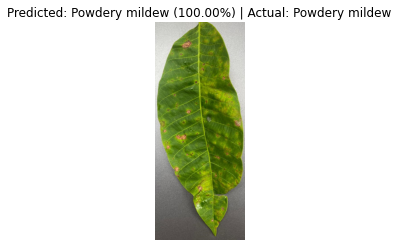

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.11.36 PM (4).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


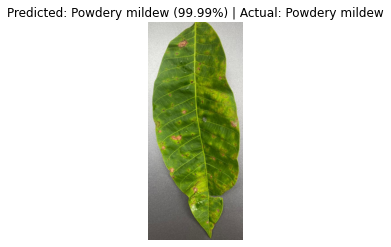

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.11.36 PM (5).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 99.99%


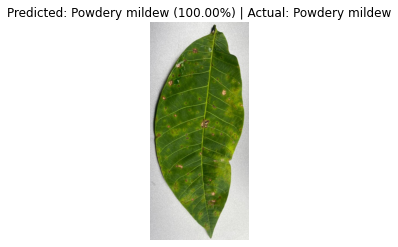

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.11.36 PM (8).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


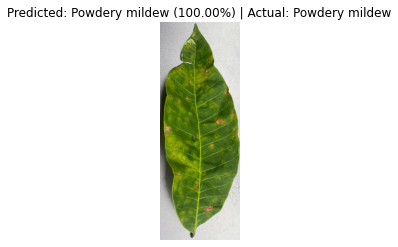

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.11.36 PM.jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


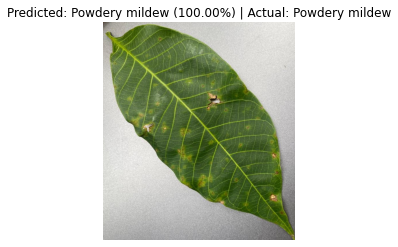

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.13.38 PM (1).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


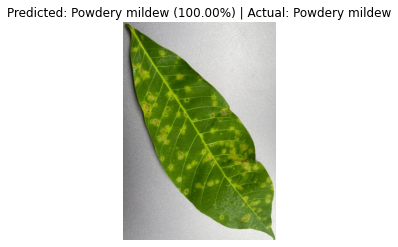

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.13.52 PM (3).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


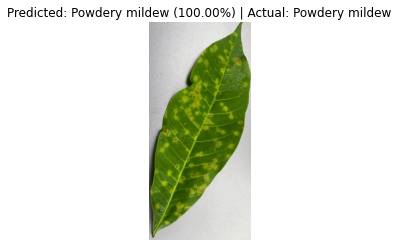

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.13.52 PM (5).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


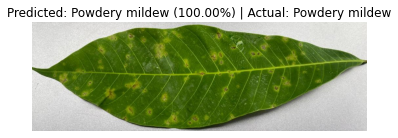

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.22.13 PM (1).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


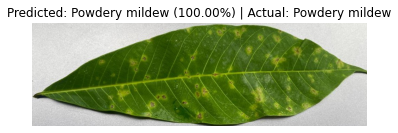

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.22.14 PM (2).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


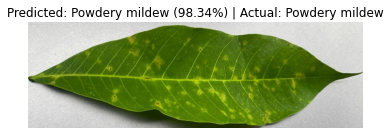

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.22.17 PM.jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 98.34%


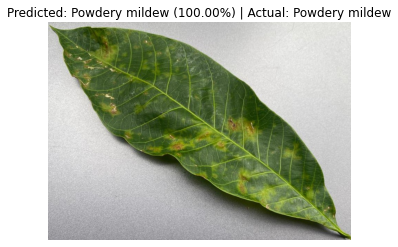

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.39.04 PM (1).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


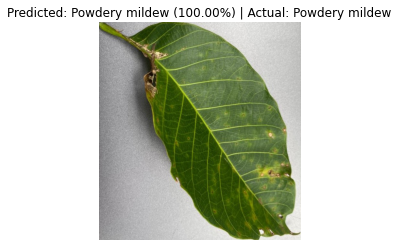

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.40.06 PM (3).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


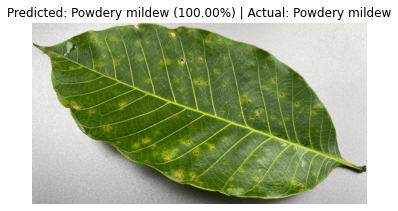

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.40.08 PM (3).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


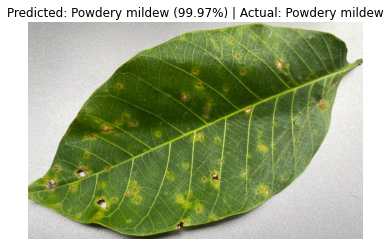

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.42.00 PM (5).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 99.97%


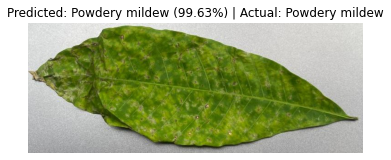

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.42.01 PM (3).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 99.63%


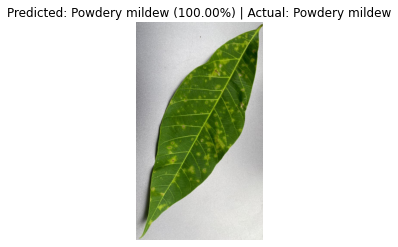

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.43.05 PM (11).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 100.00%


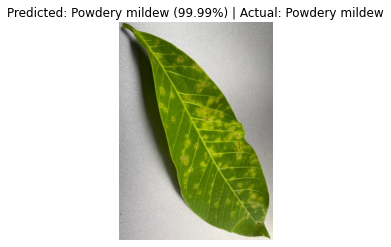

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.43.05 PM (25).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 99.99%


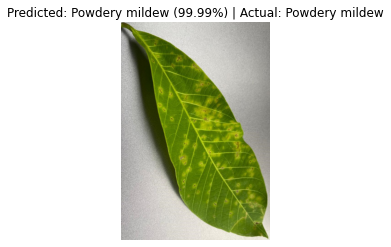

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.43.05 PM (26).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 99.99%


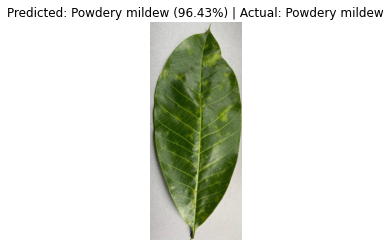

Image: Powdery mildew\WhatsApp Image 2023-03-22 at 4.45.07 PM (7).jpeg | Predicted: Powdery mildew | Actual: Powdery mildew | Confidence: 96.43%


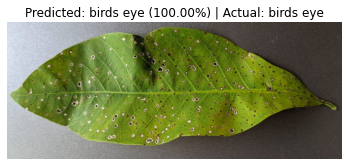

Image: birds eye\WhatsApp Image 2023-04-21 at 8.54.56 PM.jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


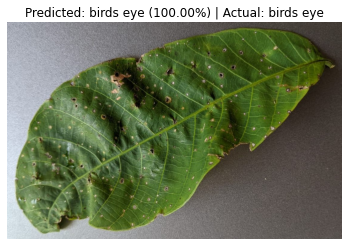

Image: birds eye\WhatsApp Image 2023-04-21 at 9.00.16 PM.jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


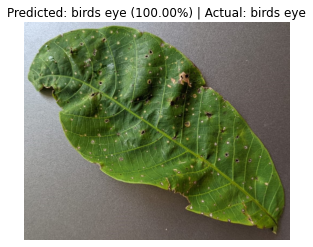

Image: birds eye\WhatsApp Image 2023-04-21 at 9.00.17 PM.jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


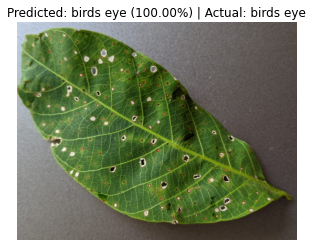

Image: birds eye\WhatsApp Image 2023-04-21 at 9.01.20 PM.jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


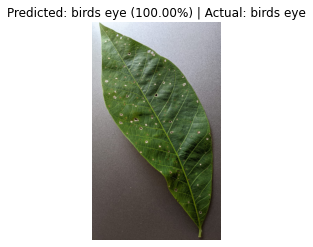

Image: birds eye\WhatsApp Image 2023-04-21 at 9.01.21 PM (1).jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


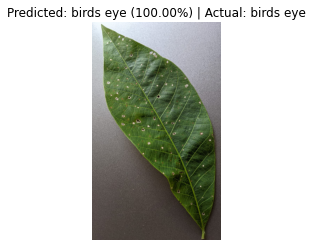

Image: birds eye\WhatsApp Image 2023-04-21 at 9.01.22 PM.jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


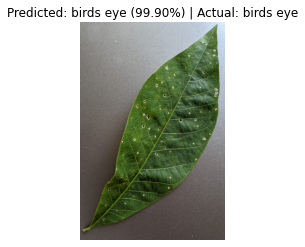

Image: birds eye\WhatsApp Image 2023-04-21 at 9.01.23 PM.jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 99.90%


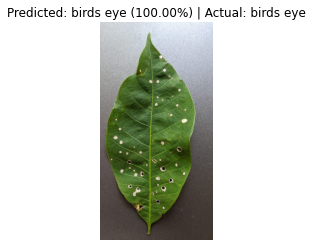

Image: birds eye\WhatsApp Image 2023-04-21 at 9.01.27 PM.jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


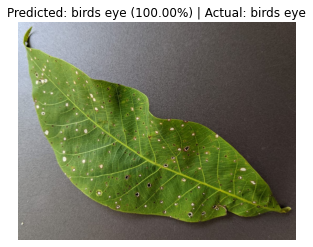

Image: birds eye\WhatsApp Image 2023-04-21 at 9.01.38 PM (1).jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


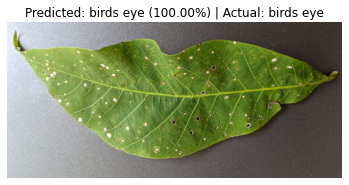

Image: birds eye\WhatsApp Image 2023-04-21 at 9.01.39 PM (1).jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


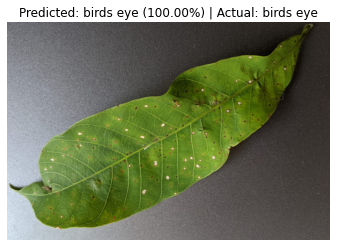

Image: birds eye\WhatsApp Image 2023-04-21 at 9.01.40 PM (1).jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


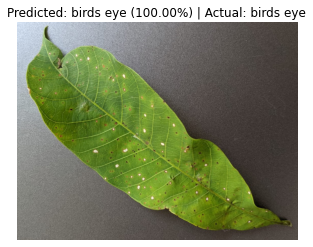

Image: birds eye\WhatsApp Image 2023-04-21 at 9.01.41 PM.jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


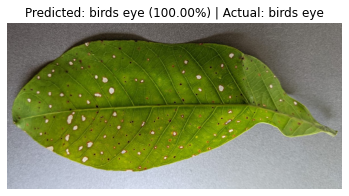

Image: birds eye\WhatsApp Image 2023-04-21 at 9.01.46 PM (1).jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


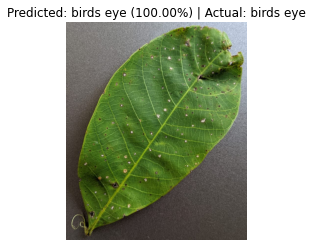

Image: birds eye\WhatsApp Image 2023-04-21 at 9.03.28 PM.jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


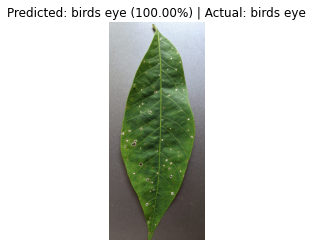

Image: birds eye\WhatsApp Image 2023-04-21 at 9.03.46 PM.jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


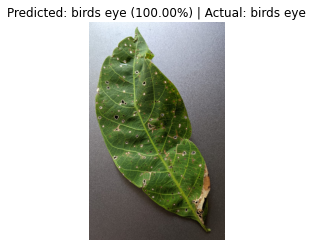

Image: birds eye\WhatsApp Image 2023-04-21 at 9.03.52 PM (1).jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


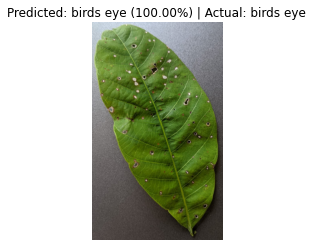

Image: birds eye\WhatsApp Image 2023-04-21 at 9.04.00 PM.jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


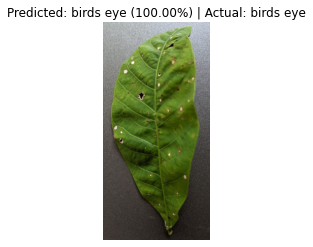

Image: birds eye\WhatsApp Image 2023-04-21 at 9.04.02 PM (1).jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


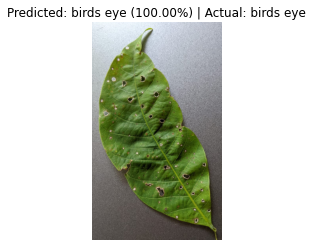

Image: birds eye\WhatsApp Image 2023-04-21 at 9.04.06 PM.jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


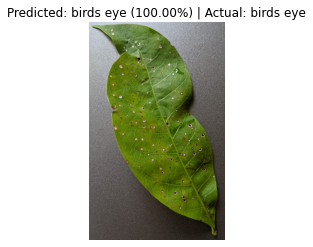

Image: birds eye\WhatsApp Image 2023-04-21 at 9.04.12 PM (1).jpeg | Predicted: birds eye | Actual: birds eye | Confidence: 100.00%


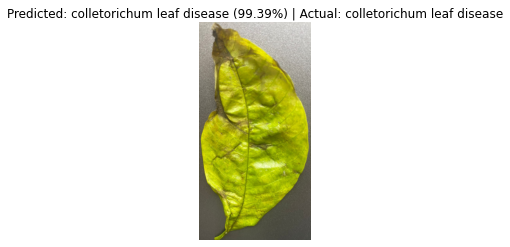

Image: colletorichum leaf disease\IMG-20230322-WA0011.jpg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.39%


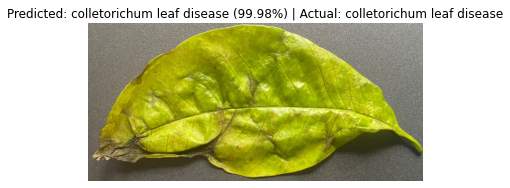

Image: colletorichum leaf disease\IMG-20230322-WA0012(1).jpg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.98%


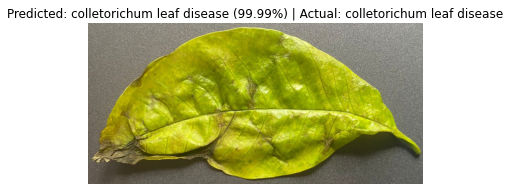

Image: colletorichum leaf disease\IMG-20230322-WA0012.jpg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.99%


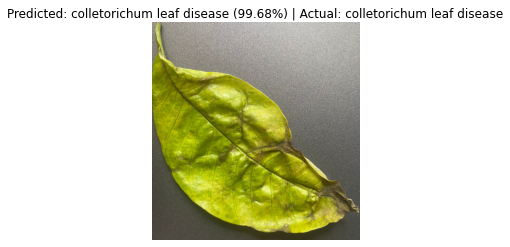

Image: colletorichum leaf disease\IMG-20230322-WA0022.jpg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.68%


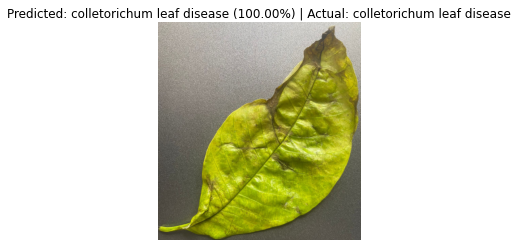

Image: colletorichum leaf disease\IMG-20230322-WA0023.jpg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 100.00%


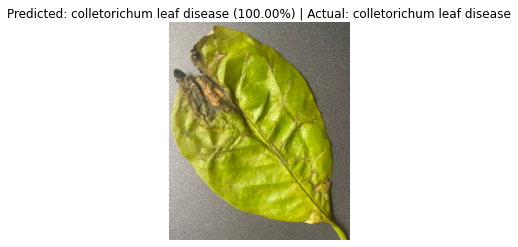

Image: colletorichum leaf disease\IMG-20230322-WA0026.jpg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 100.00%


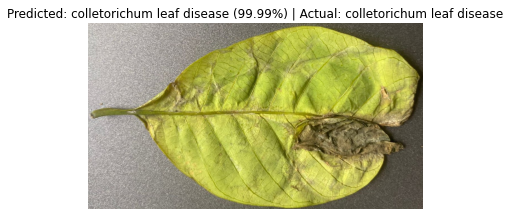

Image: colletorichum leaf disease\IMG-20230322-WA0028.jpg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.99%


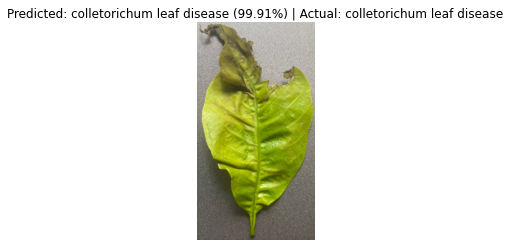

Image: colletorichum leaf disease\IMG-20230322-WA0034.jpg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.91%


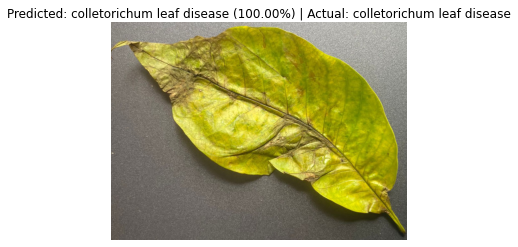

Image: colletorichum leaf disease\IMG-20230322-WA0053.jpg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 100.00%


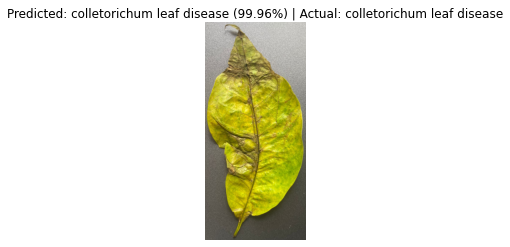

Image: colletorichum leaf disease\IMG-20230322-WA0055.jpg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.96%


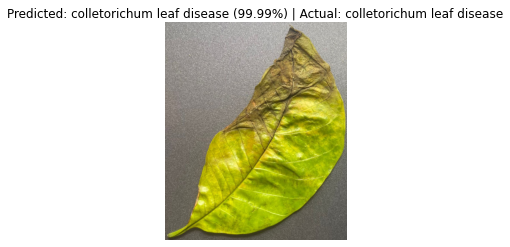

Image: colletorichum leaf disease\IMG-20230322-WA0057.jpg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.99%


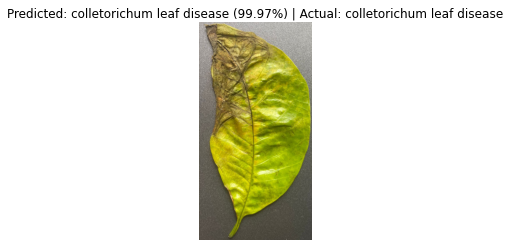

Image: colletorichum leaf disease\IMG-20230322-WA0060.jpg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.97%


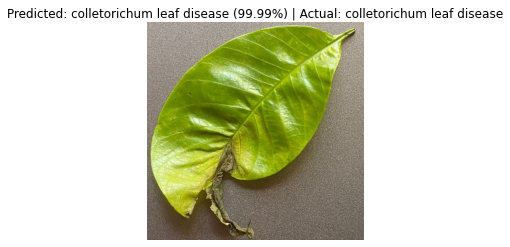

Image: colletorichum leaf disease\WhatsApp Image 2023-03-22 at 1.35.45 PM.jpeg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.99%


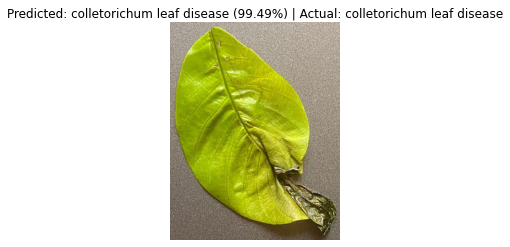

Image: colletorichum leaf disease\WhatsApp Image 2023-03-22 at 1.44.44 PM.jpeg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.49%


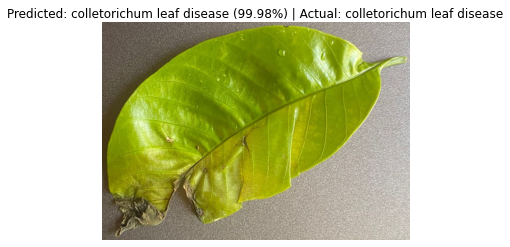

Image: colletorichum leaf disease\WhatsApp Image 2023-03-22 at 1.45.27 PM.jpeg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.98%


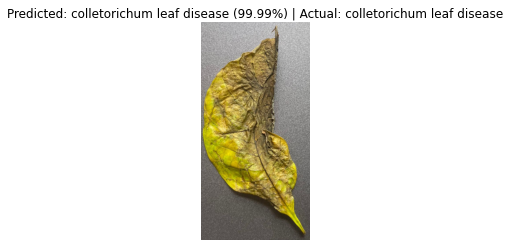

Image: colletorichum leaf disease\WhatsApp Image 2023-03-22 at 12.33.20 PM (1).jpeg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.99%


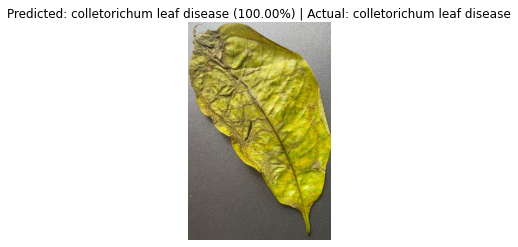

Image: colletorichum leaf disease\WhatsApp Image 2023-03-22 at 12.33.40 PM (2).jpeg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 100.00%


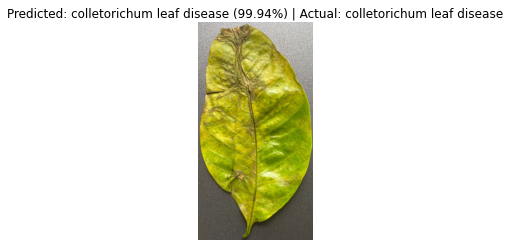

Image: colletorichum leaf disease\WhatsApp Image 2023-03-22 at 12.33.53 PM (2).jpeg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.94%


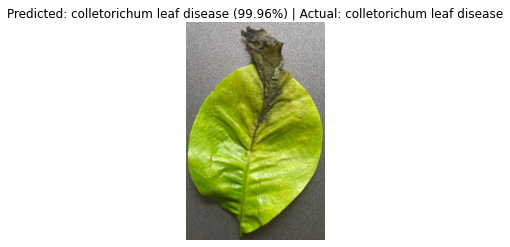

Image: colletorichum leaf disease\WhatsApp Image 2023-03-22 at 12.34.02 PM.jpeg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.96%


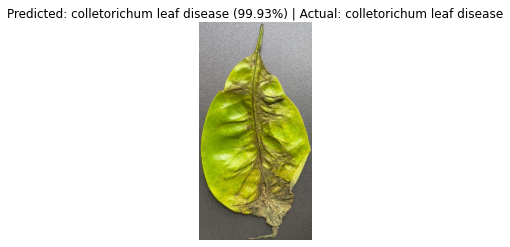

Image: colletorichum leaf disease\WhatsApp Image 2023-03-22 at 12.34.28 PM.jpeg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.93%


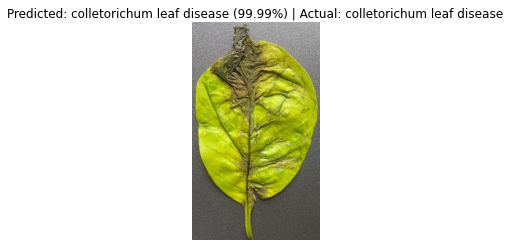

Image: colletorichum leaf disease\WhatsApp Image 2023-03-22 at 12.34.29 PM (1).jpeg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.99%


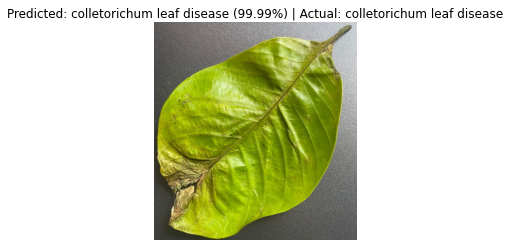

Image: colletorichum leaf disease\WhatsApp Image 2023-03-22 at 12.34.51 PM (2).jpeg | Predicted: colletorichum leaf disease | Actual: colletorichum leaf disease | Confidence: 99.99%


In [34]:
from PIL import Image
import matplotlib.pyplot as plt

# Get predictions from the model
predictions = final_model.predict(test_batches)

# Convert predicted probabilities to class labels
predicted_labels = predictions.argmax(axis=-1)

# Get actual labels from the 'test_batches' object
actual_labels = test_batches.classes

# Get class names from the 'test_batches' object
class_names = list(test_batches.class_indices.keys())

# Iterate through the test batch and display image, predicted label, actual label, and confidence percentage
for i in range(len(test_batches.filenames)):
    image_filename = test_batches.filenames[i]
    predicted_class_name = class_names[predicted_labels[i]]
    actual_class_name = class_names[actual_labels[i]]
    
    # Get the confidence percentage for the predicted class
    confidence_percentage = predictions[i][predicted_labels[i]] * 100.0
    
    # Load and display the image using PIL
    image_path = "C:/Users/User/Desktop/Models(FYP)/mobileNet_Try/dataset/test/" + image_filename  # Replace with the actual path to your test dataset
    image = Image.open(image_path)
    plt.imshow(image)
    plt.title(f"Predicted: {predicted_class_name} ({confidence_percentage:.2f}%) | Actual: {actual_class_name}")
    plt.axis('off')
    plt.show()
    
    print(f"Image: {image_filename} | Predicted: {predicted_class_name} | Actual: {actual_class_name} | Confidence: {confidence_percentage:.2f}%")
